In [5]:
import pandas as pd
import numpy as np
from pyproj import Proj, transform
from pyproj import Transformer
import matplotlib.pyplot as plt
import folium
from IPython.display import display
from matplotlib import cm
import seaborn as sns
from matplotlib.ticker import PercentFormatter
from scipy.stats import ttest_ind
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
plt.style.use('ggplot')


In [6]:
TRAN_2193_TO_4326 = Transformer.from_crs("EPSG:2193", "EPSG:4326")
def transform_coord(lat, lon):
    return TRAN_2193_TO_4326.transform(lat, lon)


In [7]:
raw_df = pd.read_csv("/Users/yasirmuhammad/Downloads/Crash_Analysis_System_(CAS)_data.csv")
raw_df.head(10)


,X,Y,OBJECTID,advisorySpeed,areaUnitID,bicycle,bridge,bus,carStationWagon,cliffBank,...,train,tree,truck,unknownVehicleType,urban,vanOrUtility,vehicle,waterRiver,weatherA,weatherB
0,1406914.0,4915023.0,1,NaN,602800.0,0.0,NaN,0.0,1.0,NaN,...,NaN,NaN,0.0,0.0,Urban,1.0,NaN,NaN,Fine,Null
1,1799023.0,5814728.0,2,NaN,528900.0,0.0,NaN,0.0,3.0,NaN,...,NaN,NaN,0.0,0.0,Urban,0.0,NaN,NaN,Fine,Null
2,1741193.0,5976099.0,3,55.0,506660.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,Open,0.0,0.0,0.0,Light rain,Null
3,1790288.0,5837387.0,4,NaN,526601.0,0.0,0.0,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,Open,0.0,0.0,0.0,Light rain,Null
4,1615675.0,5423627.0,5,NaN,584201.0,0.0,NaN,0.0,2.0,NaN,...,NaN,NaN,0.0,0.0,Urban,0.0,NaN,NaN,Fine,Null
5,1838932.0,5519398.0,6,NaN,577900.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,Open,0.0,0.0,0.0,Heavy rain,Null
6,1893341.0,5812746.0,7,NaN,538502.0,0.0,NaN,0.0,1.0,NaN,...,NaN,NaN,0.0,0.0,Open,1.0,NaN,NaN,Fine,Null
7,1570406.0,5178315.0,8,NaN,594600.0,0.0,0.0,0.0,4.0,0.0,...,0.0,0.0,0.0,0.0,Urban,0.0,0.0,0.0,Fine,Null
8,1702855.0,5635351.0,9,NaN,553500.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,Open,0.0,0.0,0.0,Heavy rain,Null
9,1766331.0,5907432.0,10,NaN,522302.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,Open,0.0,0.0,0.0,Fine,Null


#### Date cleaning, transformation,and feature engineering

In [8]:
df = raw_df[['X','Y','OBJECTID','bicycle','bus','carStationWagon','crashDirectionDescription','crashLocation1','crashSeverity','crashYear','fatalCount','flatHill','holiday',
'light','minorInjuryCount','moped','motorcycle','region','speedLimit','suv','taxi','train','truck','tree','weatherA']]
cols = ['bicycle','bus','carStationWagon','fatalCount','minorInjuryCount','moped','motorcycle','suv','taxi','train','truck','tree']

df[cols] = df[cols].replace(np.nan,0)
df[cols].replace(np.nan,0)

df['holiday'] = df['holiday'].replace(np.nan,'NPH')
df['latitude'] = transform_coord(df['Y'],df['X'])[0]
df['longitude'] = transform_coord( df['Y'],df['X'])[1]
df.drop(['X','Y'],axis=1,inplace=True)

df['vehicleInvolved'] = df['suv'] + df['taxi'] + df['carStationWagon'] + df['truck'] + df['bus']
df['Time Category'] = np.where(df['crashYear']<2010,"2000s","2010s")

#### Exploratory Data Analysis

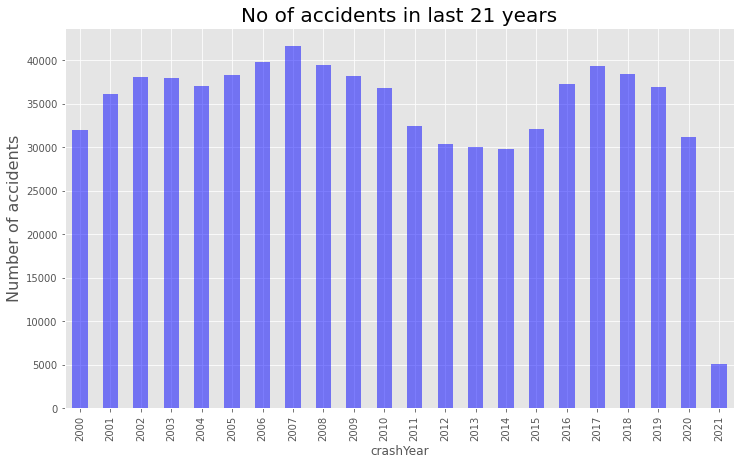

In [9]:

df.groupby('crashYear')['OBJECTID'].count().plot(kind='bar',figsize=(12,7), color='blue', alpha=0.5)
plt.title('No of accidents in last 21 years',fontsize=20)
plt.ylabel('Number of accidents',fontsize=16)
plt.show()

## A trend of increase in the no of accidents observed in early 2000s to mid-late 2000s. In late 2000s trend in decreasing the no of accidents observed which continued until 2015. In last 6 years, overall number of accidents increased each year. However, we observed decreased in no of accidents by 15% in 2020 compared to 2019. 


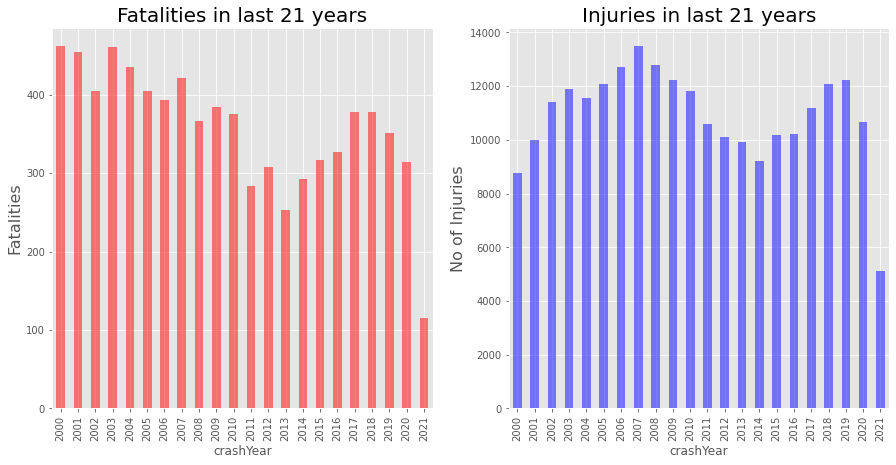

In [10]:

plt.subplot(1,2,1)

df.groupby('crashYear')['fatalCount'].sum().plot(kind='bar',figsize=(15,7), color='red', alpha=0.5)
plt.title('Fatalities in last 21 years',fontsize=20)
plt.ylabel('Fatalities',fontsize=16)

plt.subplot(1,2,2)
df.groupby('crashYear')['minorInjuryCount'].sum().plot(kind='bar',figsize=(15,7), color='blue', alpha=0.5)
plt.title('Injuries in last 21 years',fontsize=20)
plt.ylabel('No of Injuries',fontsize=16)

plt.show()

In [11]:
mean_2000s = df[(df['Time Category']=='2000s')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].mean()
mean_2010s = df[(df['Time Category']=='2010s')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].mean()
t_result = ttest_ind(df[(df['Time Category']=='2000s')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'], df[(df['Time Category']=='2010s')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'],equal_var=False)

print(f"The mean of 2000s era is {mean_2000s}, mean of 2010s era is {mean_2010s}, and t-test is {t_result}")

The mean of 2000s era is 1.144927536231884, mean of 2010s era is 1.1157449380477487, and t-test is Ttest_indResult(statistic=2.642128292866719, pvalue=0.00825710861367675)


In [12]:
mean_2000s_inj = df[(df['Time Category']=='2000s')&(df['minorInjuryCount']!=0)]['minorInjuryCount'].mean()
mean_2010s_inj = df[(df['Time Category']=='2010s')&(df['minorInjuryCount']!=0)]['minorInjuryCount'].mean()
t_result_inj = ttest_ind(df[(df['Time Category']=='2000s')&(df['minorInjuryCount']!=0)]['minorInjuryCount'], df[(df['Time Category']=='2010s')&(df['minorInjuryCount']!=0)]['minorInjuryCount'],equal_var=False)

print(f"The mean of 2000s era is {mean_2000s_inj}, mean of 2010s era is {mean_2010s_inj}, and t-test is {t_result_inj}")

The mean of 2000s era is 1.312814465408805, mean of 2010s era is 1.239496347210917, and t-test is Ttest_indResult(statistic=23.721515653412073, pvalue=3.375856517203661e-124)


## p-value is less than 0.05, so the result is said to be  statistically significant

In [16]:
df2 = df[df['crashSeverity']=='Fatal Crash']
nz_map = folium.Map(location=[-40.9006,174.8860], zoom_start=6)

for lat, lng, label in zip(df2.latitude, df2.longitude, df2.fatalCount.astype(str)):
    if label!='0':
        
        folium.features.CircleMarker(
            [lat, lng],
            radius=3,
            color='red',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(nz_map)
nz_map

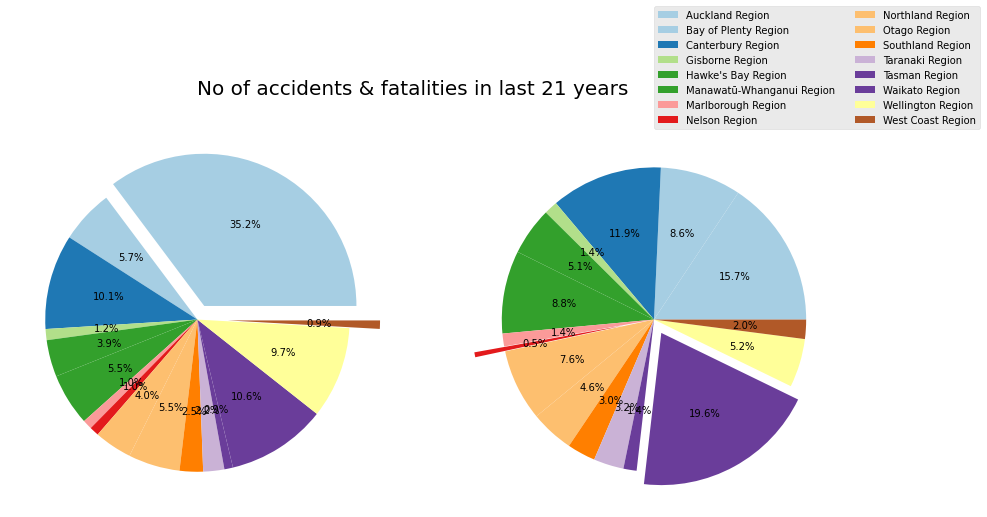

In [31]:
cs = cm.Paired(np.arange(16)/16.)
plt.subplot(1,2,1)
explode1 = (0.1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.2)
explode2 = (0,0,0,0,0,0,0,0.2,0,0,0,0,0,0.1,0,0)

df.groupby('region')['OBJECTID'].count().plot(kind='pie',figsize=(12,7),autopct='%1.1f%%',labeldistance=None,explode=explode1,colors=cs)
plt.ylabel('')
plt.subplot(1,2,2)

df.groupby('region')['fatalCount'].sum().plot(kind='pie',figsize=(15,7),autopct='%1.1f%%',labeldistance=None,explode=explode2,colors=cs)
plt.ylabel('')
plt.legend(loc=(0.5,1),ncol=2)
plt.suptitle("No of accidents & fatalities in last 21 years",size=20)
plt.show()

## Auckland region has the highest proportion of accident as compared to other regions. However, Waikato region has highest proportion (i.e. 19.6%) of fatalities in last 21 years. So, it means that severity of accident is highest in the country.

Text(0.5, 1.0, 'Pareto Chart- Accidents')

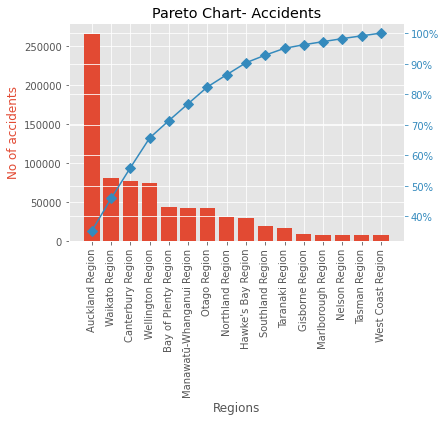

In [32]:
pareto_df =df.groupby(['region'])['OBJECTID','fatalCount'].agg({'OBJECTID':'count','fatalCount':'sum'}).reset_index().rename(columns={'OBJECTID':'accidents'})
pareto_df.sort_values(['accidents'],ascending=False,inplace=True)
pareto_df.reset_index(inplace=True)
pareto_df['%CumSum accidents'] = (100 * pareto_df['accidents'].cumsum()/pareto_df['accidents'].sum())
#pareto_df['%cumSum accidents'] = (100 * pareto_df['accidents']/pareto_df['accidents'].sum())
#pareto_df['cumSum percent'] = pareto_df['%cumSum accidents'].cumsum()
fig,ax1 = plt.subplots()
ax1.bar(pareto_df['region'],pareto_df['accidents'],color="C0")
ax1.set_ylabel('No of accidents',color="C0")
ax1.set_xlabel("Regions")
ax1.set_xticklabels(pareto_df['region'],rotation=90)
ax2=ax1.twinx()
ax2.plot(pareto_df['region'],pareto_df['%CumSum accidents'],color="C1",marker="D",ms=7)
ax2.yaxis.set_major_formatter(PercentFormatter())
ax2.tick_params(axis="y",colors="C1")
plt.title("Pareto Chart- Accidents")


Text(0.5, 1.0, 'Pareto Chart- Fatalities')

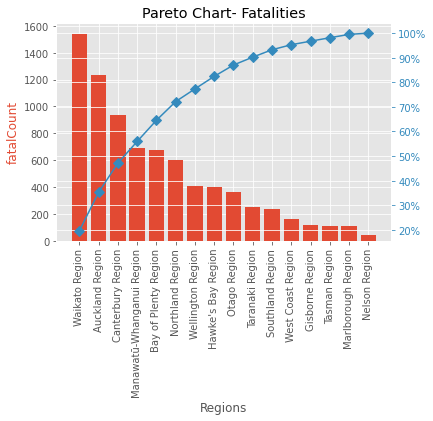

In [33]:

pareto_df.sort_values(['fatalCount'],ascending=False,inplace=True)
pareto_df.reset_index(inplace=True,drop=True)
pareto_df['%CumSum fatalcount'] = (100 * pareto_df['fatalCount'].cumsum()/pareto_df['fatalCount'].sum())
fig,ax1 = plt.subplots()
ax1.bar(pareto_df['region'],pareto_df['fatalCount'],color="C0")
ax1.set_ylabel('fatalCount',color="C0")
ax1.set_xlabel("Regions")
ax1.set_xticklabels(pareto_df['region'],rotation=90)
ax2=ax1.twinx()
ax2.plot(pareto_df['region'],pareto_df['%CumSum fatalcount'],color="C1",marker="D",ms=7)
ax2.yaxis.set_major_formatter(PercentFormatter())
ax2.tick_params(axis="y",colors="C1")
plt.title("Pareto Chart- Fatalities")

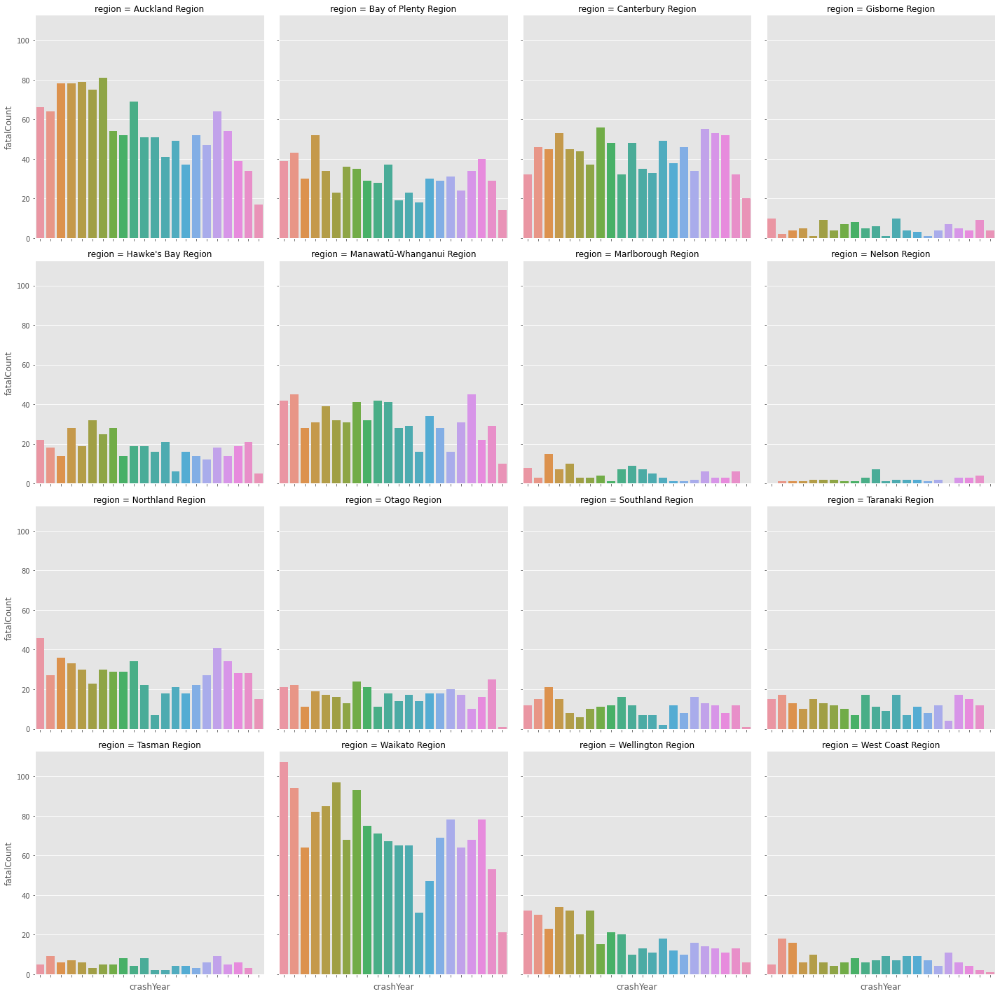

In [21]:
regions_acc = df.groupby(['crashYear','region'])['OBJECTID','fatalCount'].agg({'OBJECTID':'count','fatalCount':'sum'}).reset_index()
ax= sns.catplot(data=regions_acc,kind='bar',y='fatalCount',x='crashYear',col_wrap=4,col='region')
ax.set_xticklabels(rotation=60)

In [34]:
vehicles_involved = df['vehicleInvolved'].value_counts()
vehicles_involved.sort_index(inplace=True)
prct_vehcile_inv = 1 - (vehicles_involved[0]/vehicles_involved.sum())

prct_one_vehcile_inv =  (vehicles_involved[1]/vehicles_involved[1:].sum())
prct_two_vehcile_inv =  (vehicles_involved[2]/vehicles_involved[1:].sum())

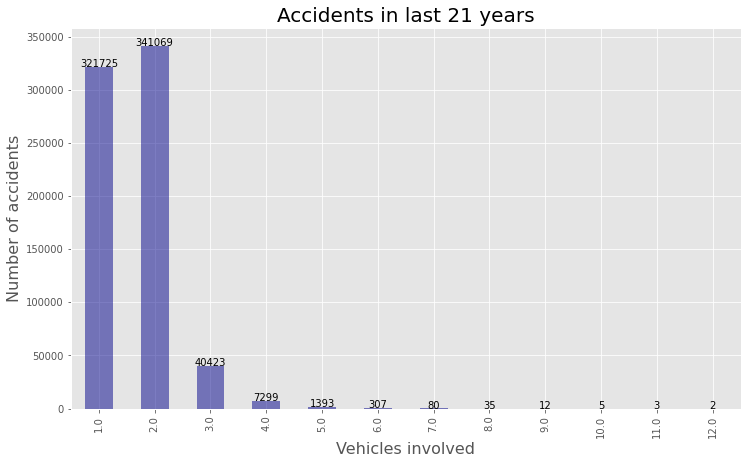

In [35]:
vehicles_involved = vehicles_involved[1:]
vehicles_involved.plot(kind='bar',figsize=(12,7), color='darkblue', alpha=0.5)
plt.title('Accidents in last 21 years',fontsize=20)
plt.xlabel('Vehicles involved',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16)


for index in vehicles_involved.index:
    
    plt.text(x=index-1,y=vehicles_involved.loc[index],s=str(vehicles_involved.loc[index]),horizontalalignment='center')
plt.show()

## Around 94% of accidents occured in last 21 years involved vehicle(s). Around 48% of those accidents involved two vehicles and about 45% of those accidents was reported as one vehcile involvement


Text(0.5, 1.0, 'Distribution of fatalities w.r.t vehcile involved')

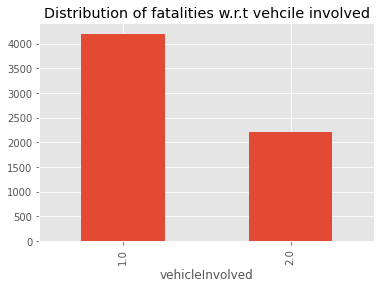

In [36]:
df[(df['vehicleInvolved']>0) & (df['vehicleInvolved']<=2)].groupby('vehicleInvolved')['fatalCount'].sum().plot(kind='bar')
plt.title("Distribution of fatalities w.r.t vehcile involved")

## About 88% more fatalities in accidents where single vehcile involved compared to accidents that have two vehciles affected.

In [40]:
vehicle_inv_df

,OBJECTID,bicycle,bus,carStationWagon,crashDirectionDescription,crashLocation1,crashSeverity,crashYear,fatalCount,flatHill,...,suv,taxi,train,truck,tree,weatherA,latitude,longitude,vehicleInvolved,Time Category
199,200,0.0,0.0,1.0,North,COMPANY ROAD,Fatal Crash,2008,1.0,Flat,...,0.0,0.0,0.0,0.0,1.0,Fine,-43.887268,171.799069,1.0,2000s
302,303,0.0,0.0,1.0,West,PUHINUI ROAD,Fatal Crash,2007,1.0,Flat,...,0.0,0.0,0.0,0.0,0.0,Fine,-36.990643,174.851215,1.0,2000s
398,399,0.0,0.0,1.0,South,OHALLORANS ROAD,Fatal Crash,2014,1.0,Flat,...,0.0,0.0,0.0,0.0,0.0,Fine,-43.229397,172.288747,1.0,2010s
558,559,0.0,0.0,1.0,Null,PIRONGIA ROAD,Fatal Crash,2009,1.0,Flat,...,1.0,0.0,0.0,0.0,0.0,Fine,-37.983418,175.263732,2.0,2000s
564,565,0.0,0.0,0.0,East,SH 12,Fatal Crash,2004,1.0,Flat,...,0.0,0.0,0.0,1.0,0.0,Fine,-36.098040,174.408585,1.0,2000s
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
758175,758176,0.0,0.0,1.0,North,SH 1N,Fatal Crash,2008,1.0,Flat,...,0.0,0.0,0.0,1.0,0.0,Light rain,-39.376530,175.711695,2.0,2000s
758291,758292,0.0,0.0,1.0,North,GREAT SOUTH ROAD,Fatal Crash,2012,1.0,Flat,...,0.0,0.0,0.0,1.0,0.0,Fine,-37.647576,175.162644,2.0,2010s
758434,758435,0.0,0.0,1.0,North,WEST BANK ROAD,Fatal Crash,2001,1.0,Flat,...,0.0,0.0,0.0,0.0,1.0,Fine,-37.935817,176.839004,1.0,2000s
758504,758505,0.0,0.0,1.0,North,SH 2,Fatal Crash,2006,1.0,Flat,...,0.0,0.0,0.0,0.0,1.0,Fine,-40.790517,175.616461,1.0,2000s


In [44]:
vehicle_inv_df = df[(df['vehicleInvolved']>0) & (df['vehicleInvolved']<=2) & (df['crashSeverity']=='Fatal Crash')]
nz_map = folium.Map(location=[-40.9006,174.8860], zoom_start=5)

for lat, lng, label, veh in zip(vehicle_inv_df.latitude, vehicle_inv_df.longitude, vehicle_inv_df.fatalCount.astype(str),vehicle_inv_df.vehicleInvolved):
    if label!='0':
        if veh == 1.0:
            
            folium.features.CircleMarker(
                [lat, lng],
                radius=3,
                color='red',
                fill=True,
                popup=label,
                fill_color='darkred',
                fill_opacity=0.6
            ).add_to(nz_map)
        
nz_map

In [45]:


nz_map = folium.Map(location=[-40.9006,174.8860], zoom_start=5)

for lat, lng, label, veh in zip(vehicle_inv_df.latitude, vehicle_inv_df.longitude, vehicle_inv_df.fatalCount.astype(str),vehicle_inv_df.vehicleInvolved):
    if label!='0':
        if veh == 2:
            
            folium.features.CircleMarker(
                [lat, lng],
                radius=3,
                color='blue',
                fill=True,
                popup=label,
                fill_color='darkred',
                fill_opacity=0.6
            ).add_to(nz_map)
        
nz_map


Text(0.5, 1.0, 'Number of Fatalities')

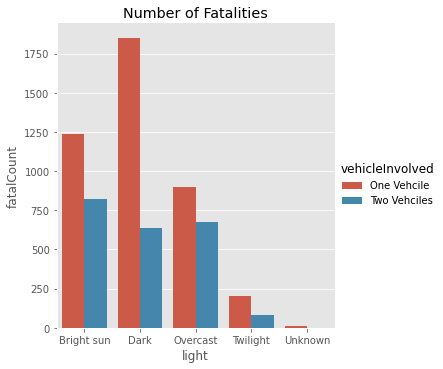

In [25]:
vehicle_type_light_count = df[(df['vehicleInvolved']>0) & (df['vehicleInvolved']<=2)].groupby(['vehicleInvolved','light'])['fatalCount'].sum().reset_index()
vehicle_type_light_count['vehicleInvolved'].replace({1.0:"One Vehcile",2.0:"Two Vehciles"},inplace=True)

sns.catplot(data=vehicle_type_light_count,x='light',y='fatalCount',kind='bar',orient='v',hue='vehicleInvolved')
plt.title('Number of Fatalities')

In [26]:
BS = df[(df['light']=='Bright sun')&(df['crashSeverity']=='Fatal Crash')&(df['vehicleInvolved']==1)]['fatalCount'].values
DK = df[(df['light']=='Dark')&(df['crashSeverity']=='Fatal Crash')&(df['vehicleInvolved']==1)]['fatalCount'].values
OC = df[(df['light']=='Overcast')&(df['crashSeverity']=='Fatal Crash')&(df['vehicleInvolved']==1)]['fatalCount'].values


K_result = stats.kruskal(BS,DK,OC)
print(f"Kruskal-Wallis H test result is {K_result} and it rejects the null hypothesis, i.e. there is significant difference among groups")

Kruskal-Wallis H test result is KruskalResult(statistic=6.011805764282692, pvalue=0.04949404685768179) and it rejects the null hypothesis, i.e. there is significant difference among groups


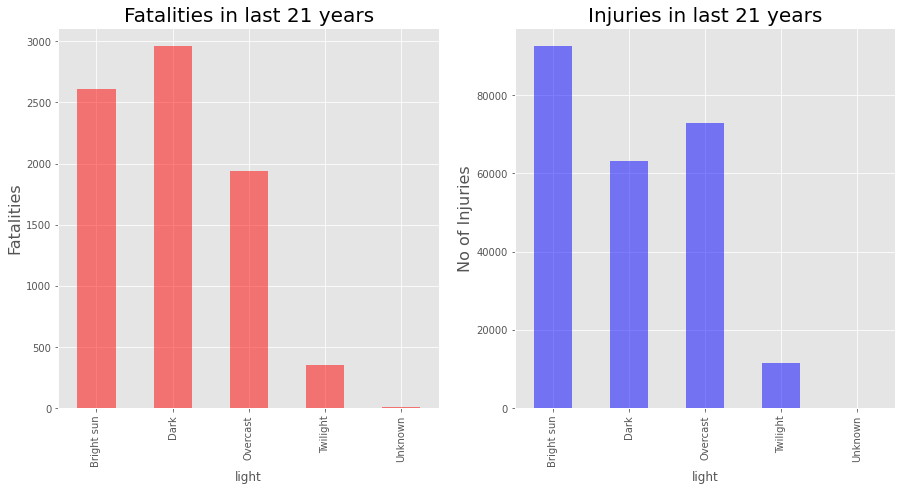

In [27]:

plt.subplot(1,2,1)

df.groupby('light')['fatalCount'].sum().plot(kind='bar',figsize=(15,7), color='red', alpha=0.5)
plt.title('Fatalities in last 21 years',fontsize=20)
plt.ylabel('Fatalities',fontsize=16)

plt.subplot(1,2,2)
df.groupby('light')['minorInjuryCount'].sum().plot(kind='bar',figsize=(15,7), color='blue', alpha=0.5)
plt.title('Injuries in last 21 years',fontsize=20)
plt.ylabel('No of Injuries',fontsize=16)

plt.show()


In [28]:
BS = df[(df['light']=='Bright sun')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].values
DK = df[(df['light']=='Dark')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].values
OC = df[(df['light']=='Overcast')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].values
TL = df[(df['light']=='Twilight')&(df['crashSeverity']=='Fatal Crash')]['fatalCount'].values

K_result = stats.kruskal(BS,DK,OC,TL)
print(f"Kruskal-Wallis H test result is {K_result} and it holds the null hypothesis, i.e. there is no significant difference among groups")

Kruskal-Wallis H test result is KruskalResult(statistic=3.6720653001427217, pvalue=0.299121874775486) and it holds the null hypothesis, i.e. there is no significant difference among groups
